In [1]:
import librosa
import matplotlib.pyplot as plt
import librosa.display
from IPython.display import Audio
import numpy as np
import glob
import os
import pandas as pd

from tqdm import tqdm
import seaborn as sns

In [33]:
df = pd.read_csv('../../Grabaciones curadas/data_catalog.csv')
df = df.query("rana_label == 'BOAFAB' and quality_label == 'C'")

In [16]:
# df

In [34]:
df.length.describe()

count    171.000000
mean       8.708116
std       28.697297
min        0.077264
25%        0.139488
50%        0.167770
75%        2.932425
max      266.574814
Name: length, dtype: float64

In [167]:
df.loc[np.isclose(df.length, np.quantile(df.length, q=0.5))].sort_values('length')
# esto audios son hasta el 50% de la base de datos y los puedo tomar solitos

,init,end,length,rana_label,quality_label,label,file,is_def,file_wav
2619,461.143411,461.311181,0.16777,BOAFAB,C,BOAFAB_C,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...,True,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...
2620,463.507441,463.675211,0.16777,BOAFAB,C,BOAFAB_C,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...,True,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...


In [171]:

df.loc[(df.length > 0.2) & (df.length <= 1)].sort_values('length')

,init,end,length,rana_label,quality_label,label,file,is_def,file_wav
2618,445.068009,445.271366,0.203357,BOAFAB,C,BOAFAB_C,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...,True,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...
2617,442.256593,442.465034,0.208441,BOAFAB,C,BOAFAB_C,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...,True,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...
2627,499.710142,499.918584,0.208442,BOAFAB,C,BOAFAB_C,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...,True,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...
2584,44.352249,44.560691,0.208442,BOAFAB,C,BOAFAB_C,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...,True,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...
2606,410.527754,410.741279,0.213525,BOAFAB,C,BOAFAB_C,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...,True,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...
2626,497.488463,497.707072,0.218609,BOAFAB,C,BOAFAB_C,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...,True,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...
2610,423.852748,424.076441,0.223693,BOAFAB,C,BOAFAB_C,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...,True,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...
2616,440.162011,440.406040,0.244029,BOAFAB,C,BOAFAB_C,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...,True,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...
2570,3.436740,3.711273,0.274533,BOAFAB,C,BOAFAB_C,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...,True,FNJV_0032289_Boana_faber_Boraceia_SP_Lucas Rod...
3368,7.593519,7.990629,0.397110,BOAFAB,C,BOAFAB_C,FNJV_0030863_Boana_faber_Campinas_SP_Celio Fer...,True,FNJV_0030863_Boana_faber_Campinas_SP_Celio Fer...


In [204]:
df.loc[(df.length > 1)].sort_values('length')


,init,end,length,rana_label,quality_label,label,file,is_def,file_wav
3768,191.975374,192.981911,1.006537,BOAFAB,C,BOAFAB_C,FNJV_0011775_Boana_faber_Jundiai_SP_Celio Fernando Baptista Haddad.txt,True,FNJV_0011775_Boana_faber_Jundiai_SP_Celio Fernando Baptista Haddad.wav
3946,15.114397,16.174178,1.059781,BOAFAB,C,BOAFAB_C,FNJV_0011068_Boana_faber_Campinas_SP_Marcio R. Martins.txt,True,FNJV_0011068_Boana_faber_Campinas_SP_Marcio R. Martins.wav
2657,554.995286,556.090230,1.094944,BOAFAB,C,BOAFAB_C,FNJV_0032140_Boana_faber_Rio de Janeiro_RJ_Bertha Lutz.txt,True,FNJV_0032140_Boana_faber_Rio de Janeiro_RJ_Bertha Lutz.wav
3362,6.739257,7.857748,1.118491,BOAFAB,C,BOAFAB_C,FNJV_0030864_Boana_faber_Campinas_SP_Celio Fernando Baptista Haddad.txt,True,FNJV_0030864_Boana_faber_Campinas_SP_Celio Fernando Baptista Haddad.wav
2334,51.652036,52.779085,1.127049,BOAFAB,C,BOAFAB_C,FNJV_0032464_Boana_faber_Feira de Santana_BA_Luis Felipe Toledo.txt,True,FNJV_0032464_Boana_faber_Feira de Santana_BA_Luis Felipe Toledo.wav
3760,181.606529,182.754689,1.148160,BOAFAB,C,BOAFAB_C,FNJV_0011775_Boana_faber_Jundiai_SP_Celio Fernando Baptista Haddad.txt,True,FNJV_0011775_Boana_faber_Jundiai_SP_Celio Fernando Baptista Haddad.wav
3464,203.830564,205.104085,1.273521,BOAFAB,C,BOAFAB_C,FNJV_0030856_Boana_faber_Ubatuba_SP_Jacques Vielliard.txt,True,FNJV_0030856_Boana_faber_Ubatuba_SP_Jacques Vielliard.wav
2791,3.722378,5.135742,1.413364,BOAFAB,C,BOAFAB_C,FNJV_0031749_Boana_faber_Ubatuba_SP_Jacques Vielliard.txt,True,FNJV_0031749_Boana_faber_Ubatuba_SP_Jacques Vielliard.wav
2656,551.600077,553.344040,1.743963,BOAFAB,C,BOAFAB_C,FNJV_0032140_Boana_faber_Rio de Janeiro_RJ_Bertha Lutz.txt,True,FNJV_0032140_Boana_faber_Rio de Janeiro_RJ_Bertha Lutz.wav
3363,0.174341,2.121149,1.946808,BOAFAB,C,BOAFAB_C,FNJV_0030863_Boana_faber_Campinas_SP_Celio Fernando Baptista Haddad.txt,True,FNJV_0030863_Boana_faber_Campinas_SP_Celio Fernando Baptista Haddad.wav


In [ ]:
## Quitar el 3468, 2645
# revisados todos los de menos de un segundo

In [4]:
df.length.sum()

4664.910709999999

In [10]:
# df.loc[df.length <= 1]

In [82]:
obs = df.loc[3768]
obs

init                                                    191.975374
end                                                     192.981911
length                                                    1.006537
rana_label                                                  BOAFAB
quality_label                                                    C
label                                                     BOAFAB_C
file             FNJV_0011775_Boana_faber_Jundiai_SP_Celio Fern...
is_def                                                        True
file_wav         FNJV_0011775_Boana_faber_Jundiai_SP_Celio Fern...
Name: 3768, dtype: object

In [19]:
wav_path = obs.file_wav
audio, sr = librosa.load(f'../../Grabaciones curadas/Grabaciones curadas/{wav_path}', sr=16000)
print('Audio Real: --------------------')
Audio(data=audio, rate=sr)

Audio Real: --------------------


In [84]:
# # waveform
# plt.figure().set_figwidth(14)
# max_min = 0.5
# plt.vlines(x=obs.init, ymin=-max_min, ymax=max_min, colors='green', linestyles='dashed', linewidth=0.7)
# plt.vlines(x=obs.end, ymin=-max_min, ymax=max_min, colors='green', linestyles='dashed', linewidth=0.7)
# librosa.display.waveshow(audio, sr=sr)

# ## Espectograma
# D = librosa.stft(audio)
# # Convert the complex-valued result to magnitude
# S_db = librosa.amplitude_to_db(abs(D), ref=np.max)
# # Display the spectrogram
# plt.figure(figsize=(14, 5))
# librosa.display.specshow(S_db, x_axis="time", y_axis="hz")
# max_min = 8000
# plt.vlines(x=obs.init, ymin=0, ymax=max_min, colors='green', linestyles='dashed', linewidth=1.7)
# plt.vlines(x=obs.end, ymin=0, ymax=max_min, colors='green', linestyles='dashed', linewidth=1.7)
# # plt.colorbar(format='%+2.0f dB')
# plt.title('Espectrograma de Frecuencia Real')
# plt.show()

# print('Audio Real: --------------------')
# Audio(data=audio, rate=sr)

In [202]:
import pandas as pd

pd.set_option('display.max_colwidth', None) 


In [209]:
(14000 * 52000) * 0.1

72800000.0

In [327]:
 int(slice_1 + np.ceil(obs.length * sr))

379615

init                                                                       29.308547
end                                                                        38.793668
length                                                                      9.485121
rana_label                                                                    BOAFAB
quality_label                                                                      C
label                                                                       BOAFAB_C
file             FNJV_0032464_Boana_faber_Feira de Santana_BA_Luis Felipe Toledo.txt
is_def                                                                          True
file_wav         FNJV_0032464_Boana_faber_Feira de Santana_BA_Luis Felipe Toledo.wav
Name: 2328, dtype: object
Audio cortado: --------------------
init::: 468936 end::: 628936
slice_size 160000
slice_size_secs 10.0


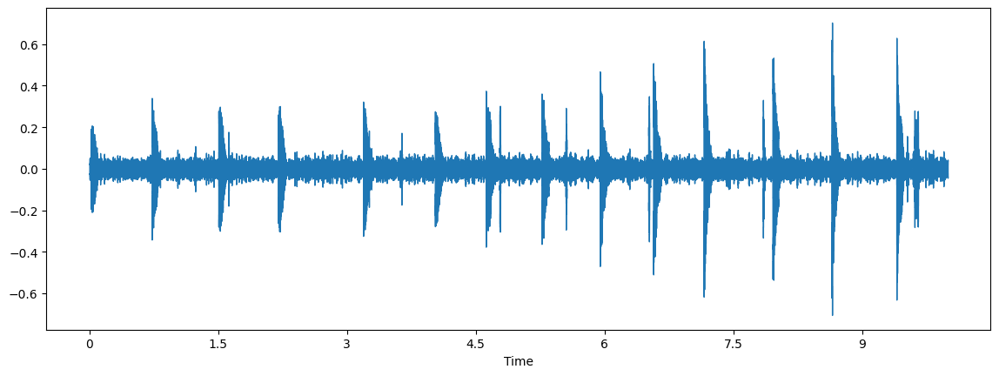

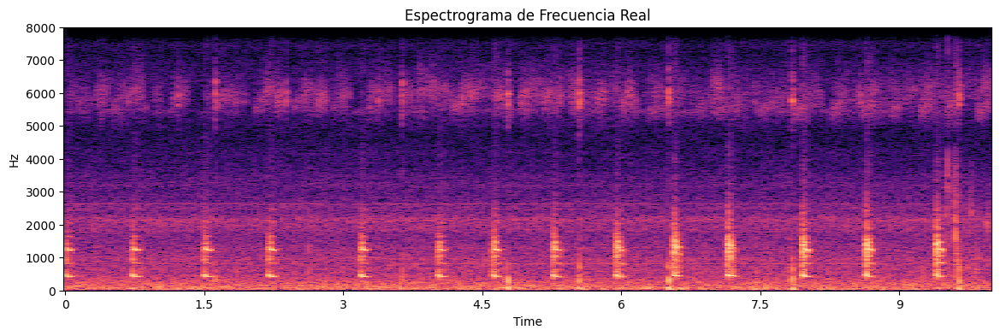

In [339]:
obs = df.loc[2328]; print(obs)

wav_path = obs.file_wav
audio, sr = librosa.load(f'../../Grabaciones curadas/Grabaciones curadas/{wav_path}', sr=16_000)
print('Audio cortado: --------------------')
add_sec_left = int(sr * -0.); add_sec_right = int(sr * 0)
slice_1 = int(obs.init * sr) - add_sec_left; slice_2 = int(obs.end * sr) + add_sec_right
if True: slice_2 = int(slice_1 + np.ceil(obs.length)* sr)
print("init:::", slice_1, "end:::", slice_2); print("slice_size", slice_2 - slice_1); print("slice_size_secs", (slice_2 - slice_1) / sr)
new_audio = audio[slice_1:slice_2]
make_plots(new_audio, sr)
Audio(data=new_audio, rate=sr)